# Baseline Detection

In [1]:
# Imports
import matplotlib.pyplot as plt
import cv2
import numpy as np

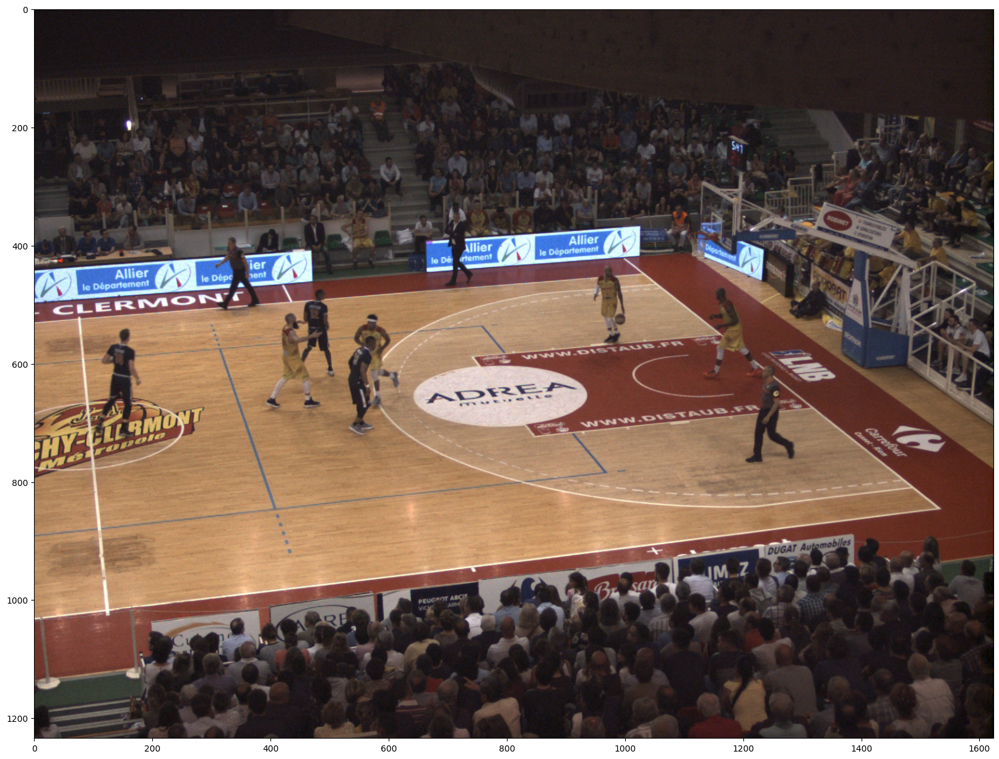

In [2]:
# Constants
IMAGE_PATH = '../test_image.png'

plt.figure(figsize=(20, 20))
plt.imshow(plt.imread(IMAGE_PATH))
plt.show()

## Select important points on the image

### First try

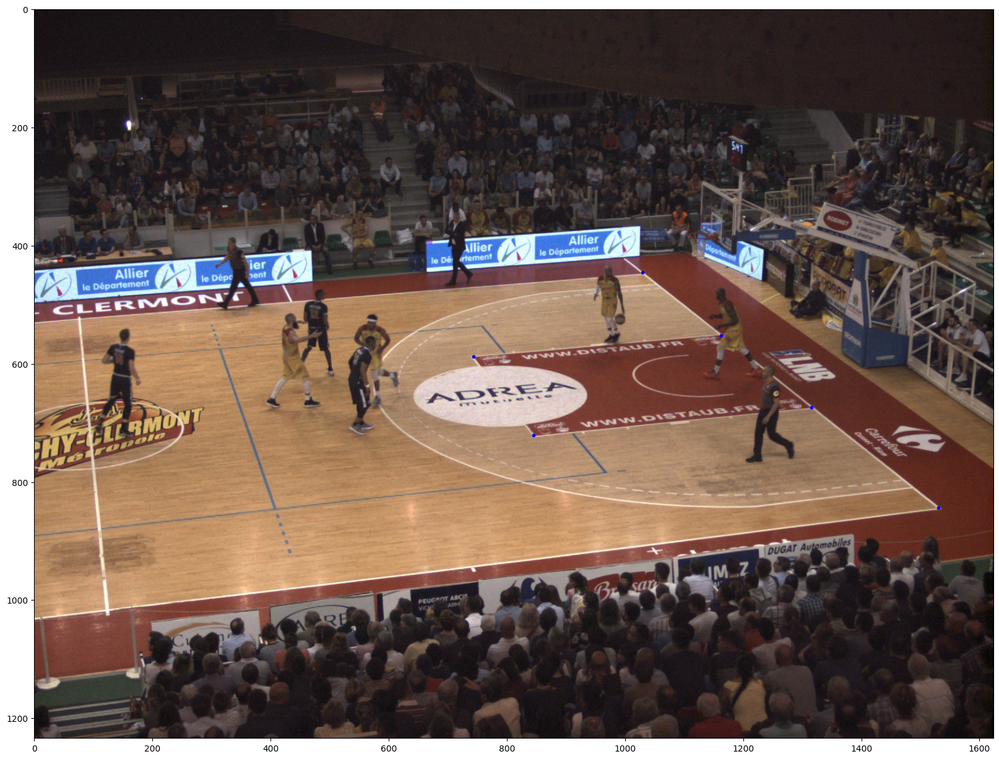

In [3]:
points = [
    (1030, 445), # Top Right Corner
    (1530, 843), # Bottom Right Corner
    (744, 588), # Top-Racket Top Right
    (845, 721), # Top-Racket Bottom Right
    (1163, 552), # Bottom-Racket Top Right
    (1316, 674), # Bottom-Racket Bottom Right
]

# Display selected points
plt.figure(figsize=(20, 20))
for point in points:
    plt.scatter(point[0], point[1], color='blue', s=10)

plt.imshow(plt.imread(IMAGE_PATH))
plt.show()

### Other

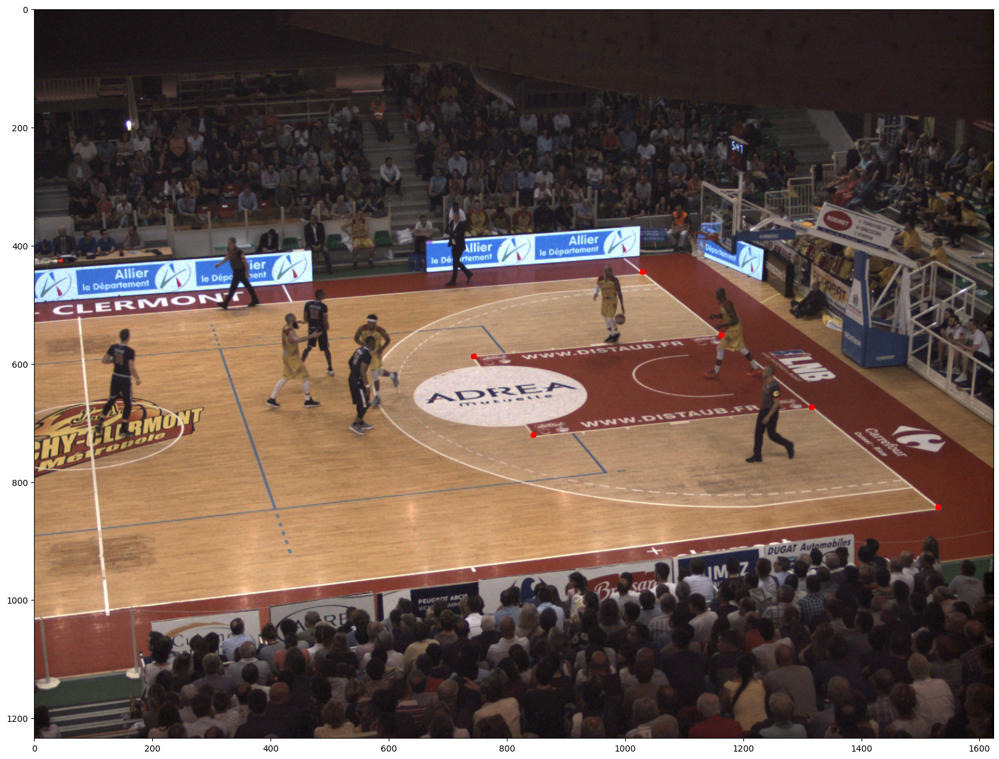

In [4]:
# Load your image
image = cv2.imread(IMAGE_PATH)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Define your six selected points manually for 'test_image.png'
selected_points = np.array([
    [1030, 445],  # Point 1
    [1530, 843],  # Point 2
    [744, 588],  # Point 3
    [845, 721],  # Point 4
    [1163, 552],  # Point 5
    [1316, 674]   # Point 6
], dtype=np.float32)

# Display the selected points on the image
for pt in selected_points:
    cv2.circle(image, tuple(pt.astype(int)), 5, (255, 0, 0), -1)

plt.figure(figsize=(20, 20))
plt.imshow(image)
plt.show()

#### 1. Compute line equations

In [5]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from itertools import combinations

# Function to compute line equation Ax + By + C = 0
def line_equation(p1, p2):
    A = p2[1] - p1[1]  # Difference in y
    B = p1[0] - p2[0]  # Difference in x
    C = p2[0] * p1[1] - p1[0] * p2[1]  # Determinant
    return A, B, C

# Compute all possible lines from selected points
lines = []
point_pairs = list(combinations(selected_points, 2))  # Get all pairs of points

for p1, p2 in point_pairs:
    lines.append((line_equation(p1, p2), p1, p2))

# Print calculated lines
for i, ((A, B, C), p1, p2) in enumerate(lines):
    print(f"Line {i+1}: ({A})x + ({B})y + ({C}) = 0 from {p1} to {p2}")


Line 1: (398.0)x + (-500.0)y + (-187440.0) = 0 from [1030.  445.] to [1530.  843.]
Line 2: (143.0)x + (286.0)y + (-274560.0) = 0 from [1030.  445.] to [744. 588.]
Line 3: (276.0)x + (185.0)y + (-366605.0) = 0 from [1030.  445.] to [845. 721.]
Line 4: (107.0)x + (-133.0)y + (-51025.0) = 0 from [1030.  445.] to [1163.  552.]
Line 5: (229.0)x + (-286.0)y + (-108600.0) = 0 from [1030.  445.] to [1316.  674.]
Line 6: (-255.0)x + (786.0)y + (-272448.0) = 0 from [1530.  843.] to [744. 588.]
Line 7: (-122.0)x + (685.0)y + (-390795.0) = 0 from [1530.  843.] to [845. 721.]
Line 8: (-291.0)x + (367.0)y + (135849.0) = 0 from [1530.  843.] to [1163.  552.]
Line 9: (-169.0)x + (214.0)y + (78168.0) = 0 from [1530.  843.] to [1316.  674.]
Line 10: (133.0)x + (-101.0)y + (-39564.0) = 0 from [744. 588.] to [845. 721.]
Line 11: (-36.0)x + (-419.0)y + (273156.0) = 0 from [744. 588.] to [1163.  552.]
Line 12: (86.0)x + (-572.0)y + (272352.0) = 0 from [744. 588.] to [1316.  674.]
Line 13: (-169.0)x + (-318.

#### 2. Find Intersections of Lines

In [6]:
# Function to compute intersection of two lines
def line_intersection(line1, line2):
    A1, B1, C1 = line1
    A2, B2, C2 = line2

    # Determinant to check if lines are parallel
    det = A1 * B2 - A2 * B1
    if det == 0:
        return None  # Lines are parallel, no intersection

    # Compute intersection point
    x = (B1 * C2 - B2 * C1) / det
    y = (A2 * C1 - A1 * C2) / det

    return (int(x), int(y))

# Find all intersections
intersections = []
for i in range(len(lines)):
    for j in range(i + 1, len(lines)):
        intersection = line_intersection(lines[i][0], lines[j][0])
        if intersection:  # Check if the intersection is within image bounds
            if 0 <= intersection[0] < image.shape[1] and 0 <= intersection[1] < image.shape[0]:
                intersections.append(intersection)

# Convert to NumPy array
intersections = np.array(intersections)

# Print found intersections
print(f"Found {len(intersections)} intersection points.")
for i, pt in enumerate(intersections):
    print(f"Intersection {i+1}: {pt}")


Found 95 intersection points.
Intersection 1: [1030  445]
Intersection 2: [1030  444]
Intersection 3: [1030  445]
Intersection 4: [1030  445]
Intersection 5: [1530  843]
Intersection 6: [1530  843]
Intersection 7: [1530  842]
Intersection 8: [1530  843]
Intersection 9: [1164  551]
Intersection 10: [1318  674]
Intersection 11: [1163  551]
Intersection 12: [1317  673]
Intersection 13: [1030  444]
Intersection 14: [1030  444]
Intersection 15: [1030  445]
Intersection 16: [744 588]
Intersection 17: [574 672]
Intersection 18: [1028  445]
Intersection 19: [1027  446]
Intersection 20: [744 588]
Intersection 21: [744 588]
Intersection 22: [744 588]
Intersection 23: [386 766]
Intersection 24: [1029  445]
Intersection 25: [1030  445]
Intersection 26: [1030  445]
Intersection 27: [900 638]
Intersection 28: [845 721]
Intersection 29: [1029  446]
Intersection 30: [1028  447]
Intersection 31: [845 721]
Intersection 32: [945 570]
Intersection 33: [916 613]
Intersection 34: [845 721]
Intersection 35: 

#### 3. Display Intersections

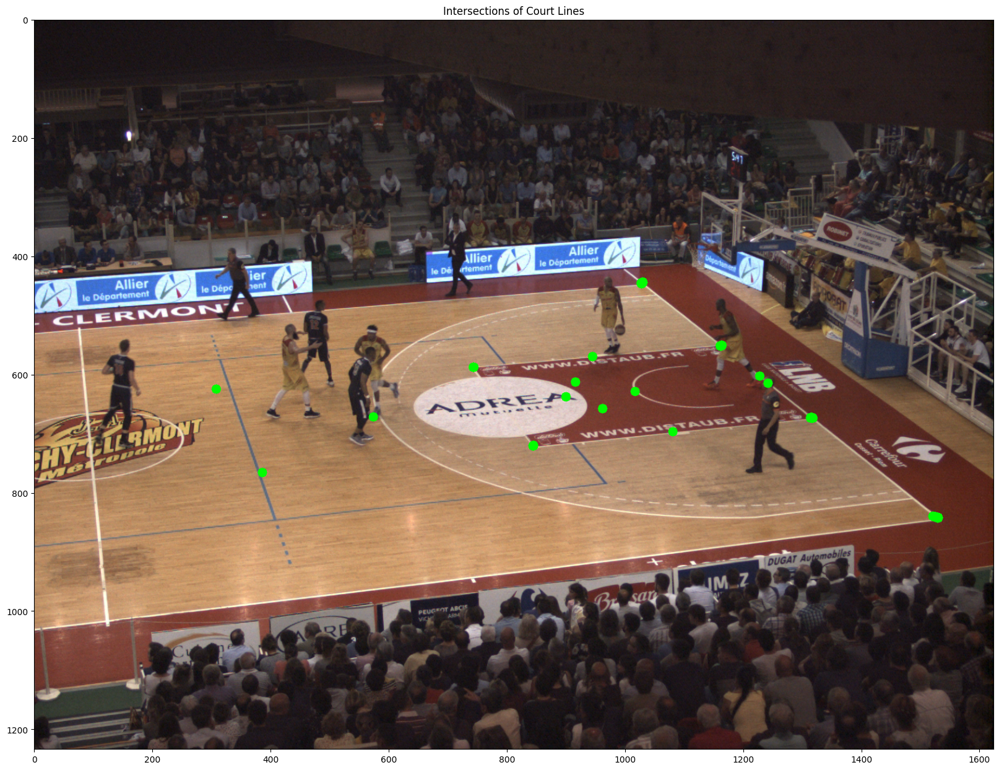

In [7]:
# Draw the intersections on the image
image_with_intersections = image.copy()

for pt in intersections:
    cv2.circle(image_with_intersections, tuple(pt), 8, (0, 255, 0), -1)  # Green dots for intersections

plt.figure(figsize=(20, 20))
plt.imshow(image_with_intersections)
plt.title("Intersections of Court Lines")
plt.show()


#### 4. Draw Intersections on Image

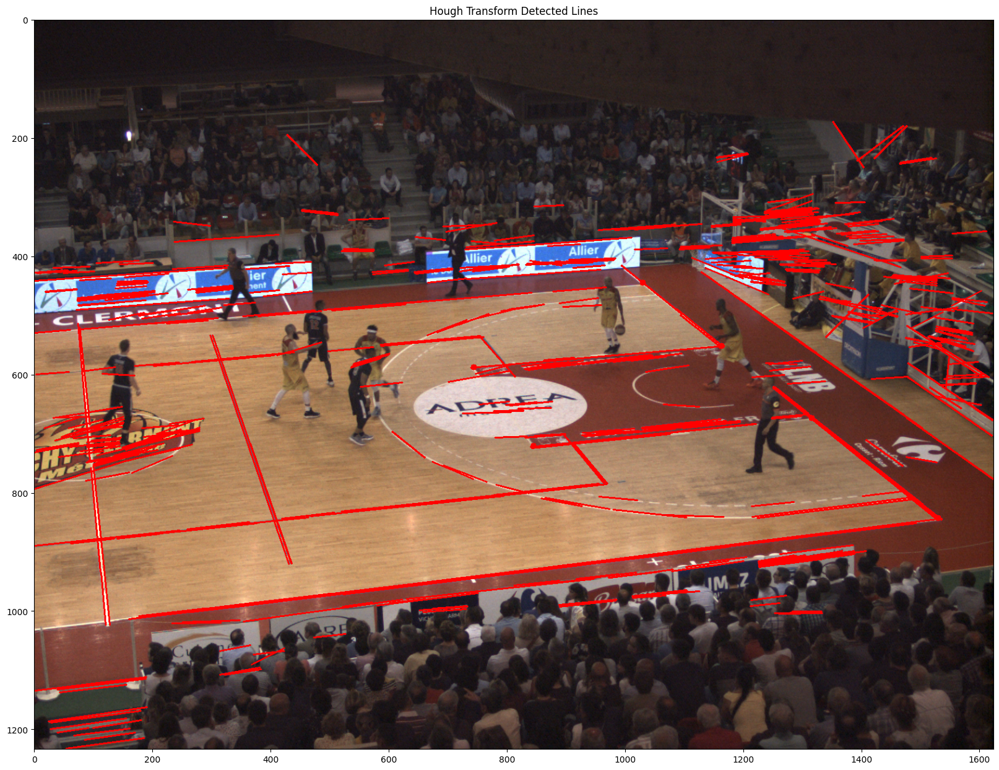

In [8]:
# Convert to grayscale
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

# Apply Canny edge detection
edges = cv2.Canny(gray, 50, 150)

# Apply Hough Line Transform
lines_detected = cv2.HoughLinesP(edges, 1, np.pi / 180, 100, minLineLength=50, maxLineGap=10)

# Draw detected lines on a copy of the image
image_hough = image.copy()
if lines_detected is not None:
    for line in lines_detected:
        x1, y1, x2, y2 = line[0]
        cv2.line(image_hough, (x1, y1), (x2, y2), (255, 0, 0), 2)

plt.figure(figsize=(20, 20))
plt.imshow(image_hough)
plt.title("Hough Transform Detected Lines")
plt.show()


### fenjcenjcn

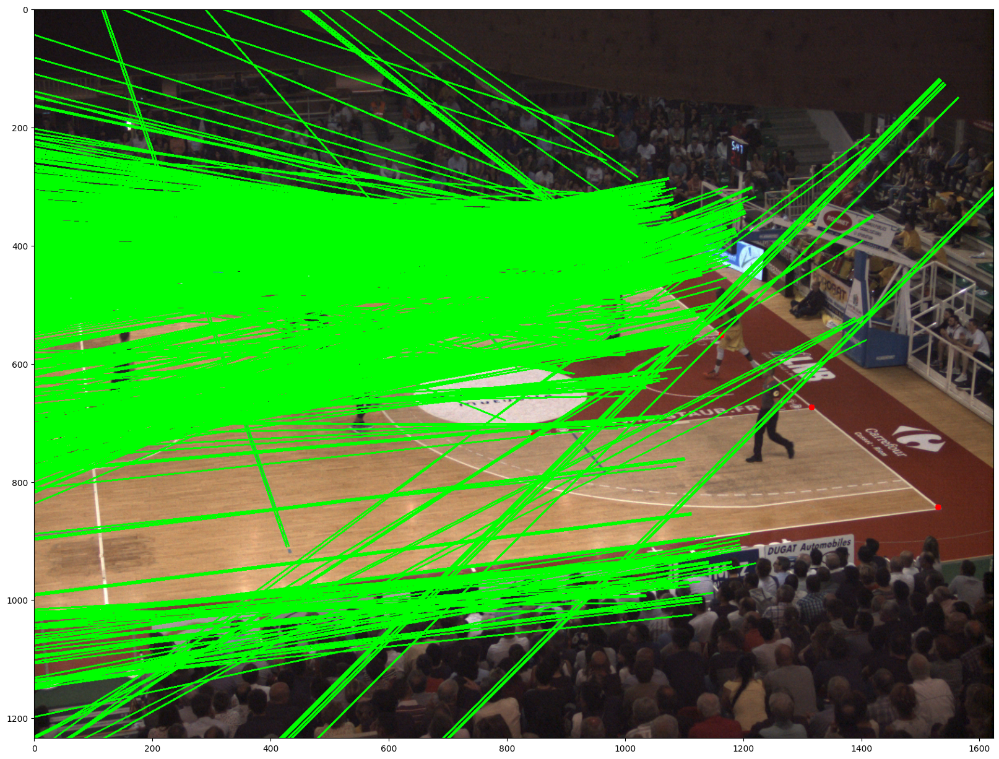

In [9]:
def detect_lines(image):
    """Detect court lines using Canny + Hough Transform"""
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray, 50, 150, apertureSize=3)

    # Detect Hough lines
    lines = cv2.HoughLines(edges, 1, np.pi / 180, 200)

    return lines


lines = detect_lines(image)

# Draw detected lines
image_lines = image.copy()
if lines is not None:
    for rho, theta in lines[:, 0]:
        a = np.cos(theta)
        b = np.sin(theta)
        x0 = a * rho
        y0 = b * rho
        pt1 = (int(x0 + 1000 * (-b)), int(y0 + 1000 * (a)))
        pt2 = (int(x0 - 1000 * (-b)), int(y0 - 1000 * (a)))
        cv2.line(image_lines, pt1, pt2, (0, 255, 0), 2)

plt.figure(figsize=(20, 20))
plt.imshow(image_lines)
plt.show()

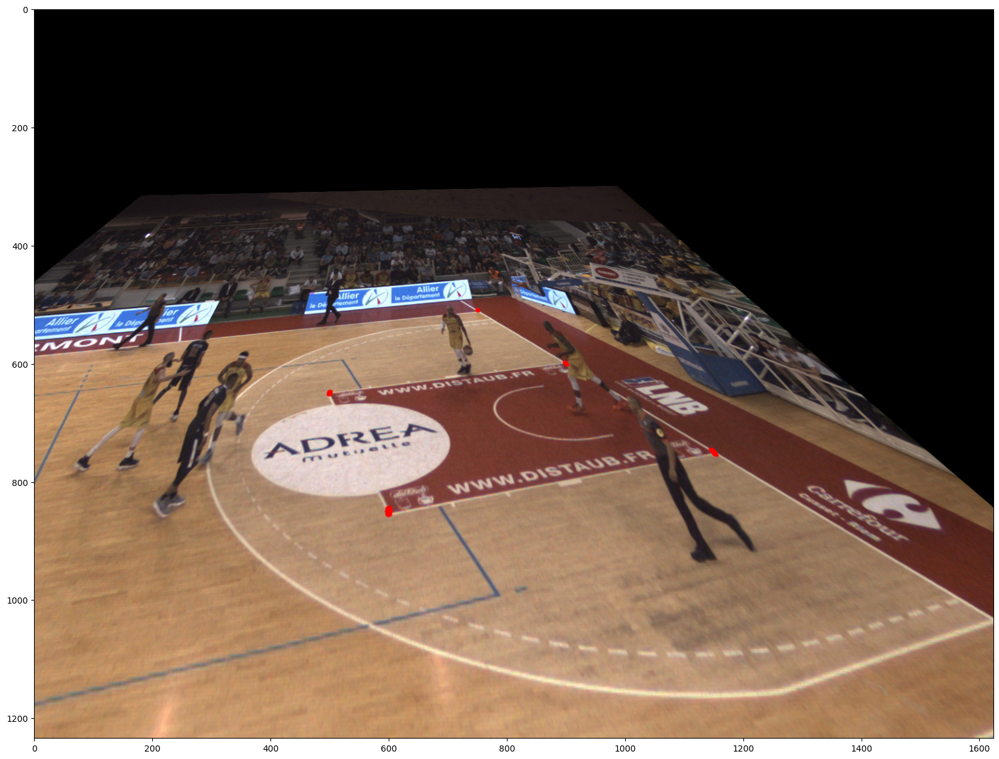

In [10]:
# Define reference court points (manually set from a standard court image)
reference_points = np.array([
    [812, 250],   # Top of Key (aligned with free-throw line)
    [1400, 850],  # Right Baseline Corner
    [500, 650],   # Left Side of Key
    [600, 850],   # Left Baseline Corner
    [900, 600],   # Middle of Key area
    [1150, 750]   # Right Side of Key near the paint
], dtype=np.float32)


# Compute homography matrix
H, _ = cv2.findHomography(selected_points, reference_points, cv2.RANSAC)

# Warp image
height, width, _ = image.shape
warped_image = cv2.warpPerspective(image, H, (width, height))

plt.figure(figsize=(20, 20))
plt.imshow(warped_image)
plt.show()


In [11]:
warped_lines = detect_lines(warped_image)

def count_valid_lines(lines):
    """Count valid horizontal and vertical lines"""
    horizontal, vertical = 0, 0
    angle_threshold = 10 * np.pi / 180  # Allowable deviation

    if lines is not None:
        for rho, theta in lines[:, 0]:
            if abs(theta - np.pi / 2) < angle_threshold:  # Vertical line
                vertical += 1
            elif abs(theta) < angle_threshold:  # Horizontal line
                horizontal += 1

    return horizontal, vertical

horiz, vert = count_valid_lines(warped_lines)

# Validate if at least 3 good lines exist
homography_valid = (horiz + vert) >= 3
print(f"Homography Valid: {homography_valid}")


Homography Valid: True
